In [79]:
import numpy as np
import matplotlib.pyplot as plt
import wave
from IPython.display import Audio
import math
import cmath

In [80]:
voice_file = wave.open("suzanne.wav")
voice_nsamp = voice_file.getnframes()
voice_signal = np.frombuffer(voice_file.readframes(voice_nsamp), dtype = np.int16)
voice_signal = voice_signal.astype(float)/2**15 # normalize to max int
voice_fs = voice_file.getframerate()*2 # Hz
voice_audio = Audio(data = voice_signal, rate = voice_fs)

voice_audio

In [81]:
music_file = wave.open("synth_with_vox.wav")
music_nsamp = music_file.getnframes()
music_signal = np.frombuffer(music_file.readframes(music_nsamp), dtype = np.int16)
music_signal = music_signal.astype(float)/2**15
music_fs = music_file.getframerate()*2 # Hz
music_audio = Audio(data = music_signal, rate = music_fs)

music_audio

In [105]:
def biquad_lowpass(fc, Q, fs):
  theta_c = 2*np.pi*fc/fs
  K = np.tan(theta_c/2)
  W = K*K
  alpha = 1 + K/Q + W

  a0 = 1
  a1 = 2*(W - 1)/alpha
  a2 = (1 - K/Q + W)/alpha

  b0 = W/alpha
  b1 = 2 * W / alpha
  b2 = b0

  return (a0, a1, a2, b0, b1, b2)

def biquad_highpass(fc, Q, fs):
  theta_c = 2*np.pi*fc/fs
  K = np.tan(theta_c/2)
  W = K*K
  alpha = 1 + K/Q + W

  a0 = 1
  a1 = 2*(W - 1)/alpha
  a2 = (1 - K/Q + W)/alpha

  b0 = 1/alpha
  b1 = -2/alpha
  b2 = b0

  return (a0, a1, a2, b0, b1, b2)

class BandPassFilter:
  def __init__(self, fc_low, fc_high, fs):
    # stored previous values set to 0
    # y_1 <-> y[n-1], etc
    self.x_1 = 0
    self.x_2 = 0
    self.int_1 = 0 # intermediate output
    self.int_2 = 0
    self.y_1 = 0 
    self.y_2 = 0
    
    Q = 2
#     Q = 1/np.sqrt(2)

    self.lp_a0, self.lp_a1, self.lp_a2, \
    self.lp_b0, self.lp_b1, self.lp_b2 = biquad_lowpass(fc_high,Q,fs)

    self.hp_a0, self.hp_a1, self.hp_a2, \
    self.hp_b0, self.hp_b1, self.hp_b2 = biquad_highpass(fc_low,Q,fs)

  def H_LP(self, z):
    lp_top = (self.lp_b0 + self.lp_b1/z + self.lp_b2/(z*z))
    lp_bottom = (self.lp_a0 + self.lp_a1/z + self.lp_a2/(z*z))
    return lp_top/lp_bottom

  def H_HP(self, z):
    hp_top = (self.hp_b0 + self.hp_b1/z + self.hp_b2/(z*z))
    hp_bottom = (self.hp_a0 + self.hp_a1/z + self.hp_a2/(z*z))
    return hp_top/hp_bottom
    
  def H(self, z):
    return self.H_HP(z)*self.H_LP(z)

  def tick(self, x):
    # first, apply low pass
    intermed_val =  (self.lp_b0*x + self.lp_b1*self.x_1 + self.lp_b2*self.x_2 \
                - self.lp_a1*self.int_1 - self.lp_a2*self.int_2)/self.lp_a0

    # second, apply high pass
    y = (1/self.hp_a0)*(self.hp_b0*intermed_val + self.hp_b1*self.int_1 + \
         self.hp_b2*self.int_2 - self.hp_a1*self.y_1 - self.hp_a2*self.y_2)
    
    # update stored values
    self.x_2 = self.x_1
    self.x_1 = x
    
    self.int_2 = self.int_1
    self.int_1 = intermed_val

    self.y_2 = self.y_1
    self.y_1 = y

    return y

class EnvelopeFollower:
  def __init__(self, tau, fs): # tau -> integration time (s)
    # stored previous values set to 0
    # y_1 <-> y[n-1], etc
    self.y_1 = 0
    self.b = 1 - np.exp(-1/(tau*fs))

  def tick(self, x): 
    # first, apply low pass
    input = x*x
    y = self.b*input + (1-self.b)*self.y_1
    self.y_1 = y
    return np.sqrt(y)

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/IPython/core/pylabtools.py:134: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


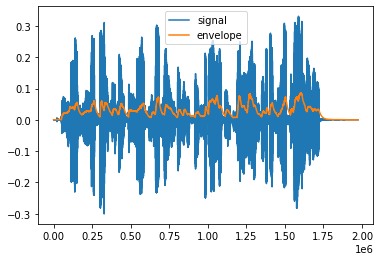

In [96]:
# Test band pass
filter = BandPassFilter(300, 500, voice_fs)
env_follower = EnvelopeFollower(0.1, voice_fs)

y = []
envelope = []
for sample in voice_signal:
  y.append(filter.tick(sample))
  envelope.append(env_follower.tick(sample))

n = np.arange(len(y))
plt.plot(n, y, label='signal')
plt.plot(n, envelope, label="envelope")
plt.legend()
plt.show()

Audio(data = y, rate = voice_fs)

(21.36882332087611, 36.28987809907338)
(41.427310045012604, 70.35446027752486)
(80.31429675816315, 136.39478389617983)
(155.70371952100365, 264.4258374053452)
(301.8596844055817, 512.6370781212579)
(585.209328009315, 993.8392421987596)
(1134.5336104206876, 1926.7362457550776)
(2199.4976012304996, 3735.324993299005)
(4264.121973455558, 7241.599796705046)
(8266.767917516376, 14039.144575027552)


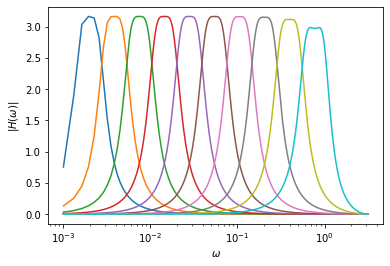

In [106]:
# siganl1: control signal which is spectrally analyzed to modify the original signal
# signal2: signal which has the band pass filters applied to it

# NOTE: MUST HAVE SAME SAMPLE RATE.

def vocoder(signal1, signal2, fs, n_bands=5, spacing='logarithmic', plot_bands=True):
  
  # cut off longer signal
  if len(signal1) > len(signal2):
    s2 = np.copy(signal2)
    s1 = np.copy(signal1)[:len(s2)]
  elif len(signal2) > len(signal1):
    s1 = np.copy(signal1)
    s2 = np.copy(signal2)[:len(s1)]
  else:
    s1 = np.copy(signal1)
    s2 = np.copy(signal2)

  min_freq_band = 20 # Hz
  max_freq_band = 15000 #z
  base = (max_freq_band/min_freq_band)**(1/n_bands)
  tau = 0.01

  # Initialize BPFs and EvelopeFollowers
  s1_filters = []
  s1_envelopes = []
  s2_filters = []
  s2_envelopes = []
  w = np.linspace(0.001, np.pi, 10000)
  for band in range(n_bands):
    # signal 1 BPFs
    min = min_freq_band*(base**(band+0.1))
    max = min_freq_band*(base**(band+0.9))
    if spacing == 'linear':
        min = min_freq_band + band*(max_freq_band - min_freq_band)/n_bands
        max = min_freq_band + (band+1)*(max_freq_band - min_freq_band)/n_bands
    print(f"({min}, {max})")

    s1_filters.append(BandPassFilter(min, max, fs))
    s1_envelopes.append(EnvelopeFollower(tau, fs))
    s2_filters.append(BandPassFilter(min, max, fs))
    s2_envelopes.append(EnvelopeFollower(tau, fs))
    
#     if band == n_bands // 2:
#         H = abs(s1_filters[-1].H(np.exp(1j*w)))
#         plt.plot(w, abs(H), label="Band Pass")
    
#         H_HP = abs(s1_filters[-1].H_HP(np.exp(1j*w)))
#         plt.plot(w, abs(H_HP), label="High Pass")
        
#         H_LP = abs(s1_filters[-1].H_LP(np.exp(1j*w)))
#         plt.plot(w, abs(H_LP), label="Low Pass")
    
    if plot_bands:
        H = abs(s1_filters[-1].H(np.exp(1j*w)))
        plt.plot(w, abs(H), label=f'band {band}')
    
  plt.xlabel("$\omega$")
  plt.xscale('log')
  plt.ylabel("$|H(\omega)|$")
#   plt.legend()
  plt.show()

  # multiply by the BPF outputs
  y = []
  for samp in range(len(s1)):
    out = 0
    for band in range(n_bands):
      a = s1_filters[band].tick(s1[samp])
      b = s1_envelopes[band].tick(a)
      c = s2_filters[band].tick(s2[samp])
      d = s2_envelopes[band].tick(c)

#       if d != 0:
#         c = c/d  # whitening

      out += c*b
    y.append(out)

  return y

y = vocoder(voice_signal, music_signal, voice_fs, n_bands=10)
Audio(data = y, rate = voice_fs)